In [6]:
! pip install pydicom
import matplotlib.pyplot as plt
import numpy as np
import pydicom
import cv2
import os

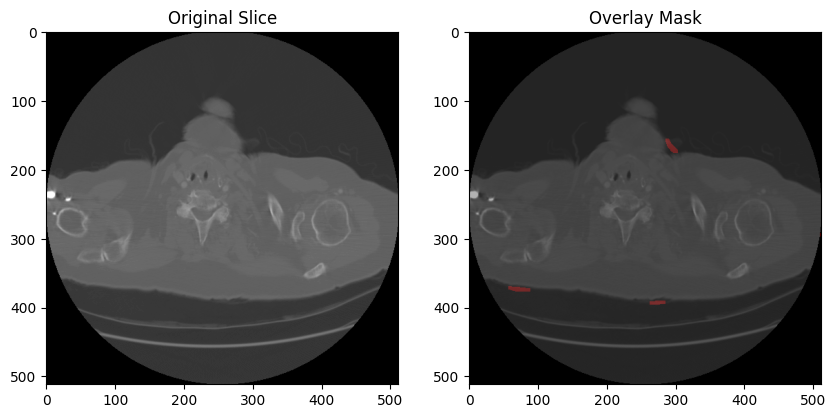

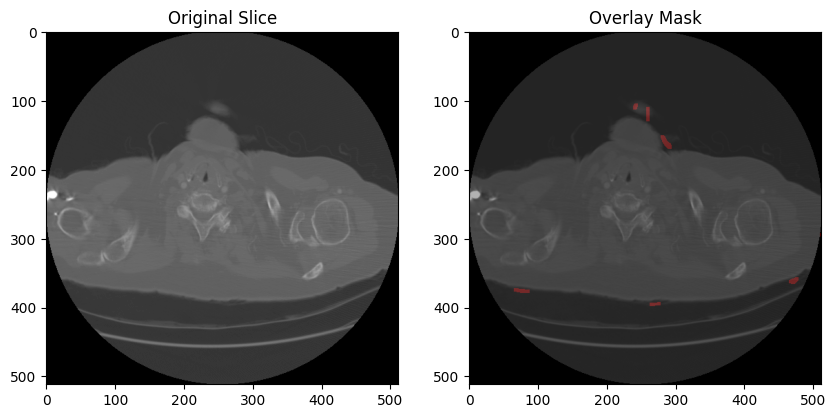

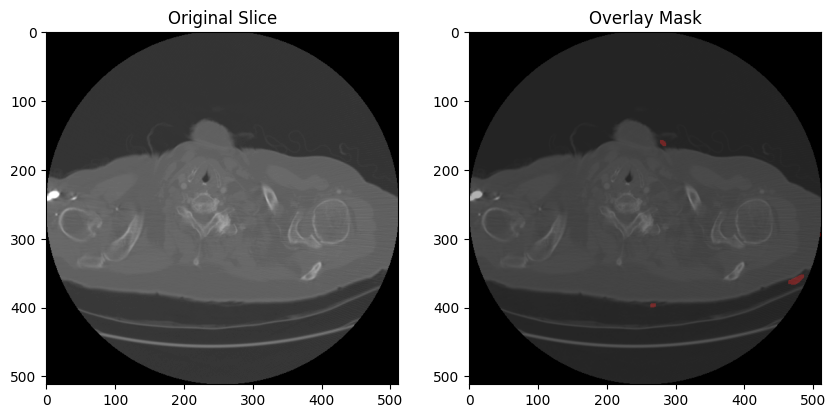

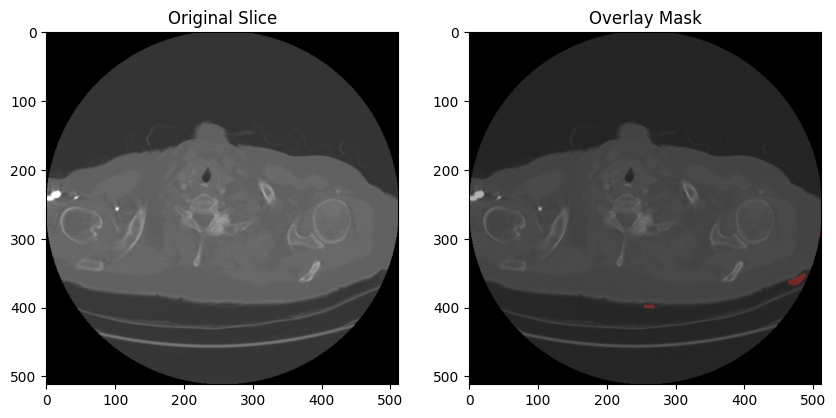

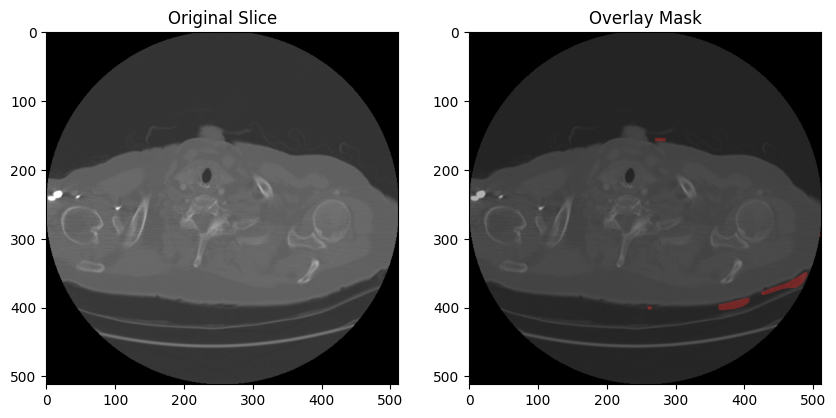

...

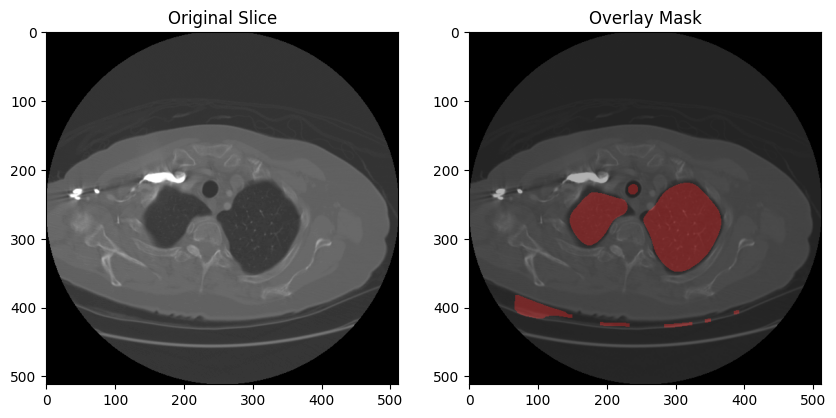

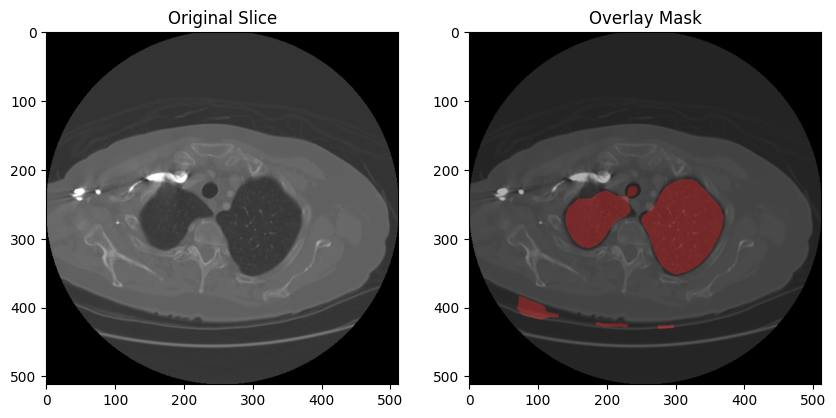

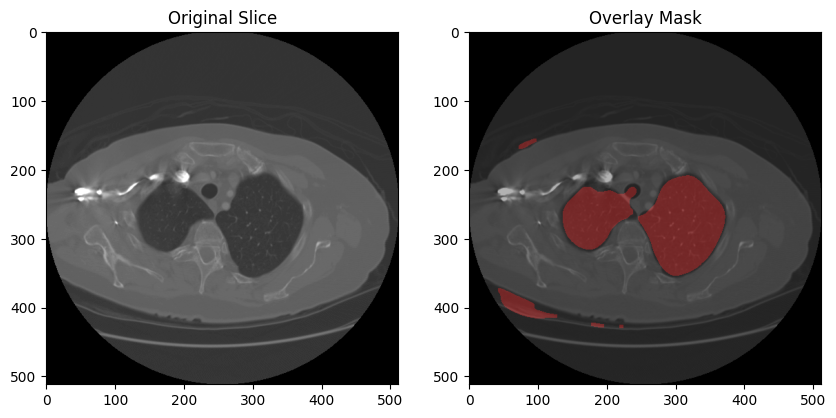

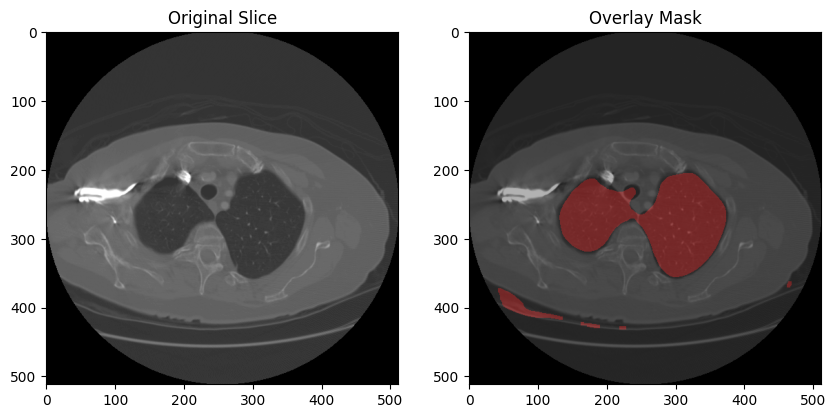

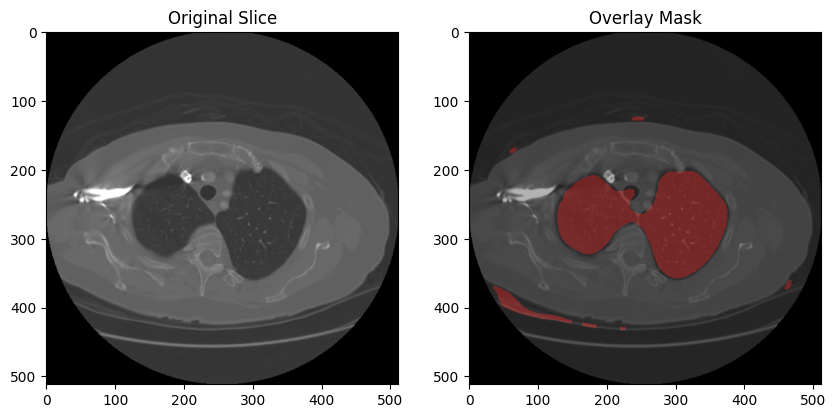

KeyboardInterrupt: 

In [351]:
import pydicom
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def load_dicom_series(directory):
    slices = []
    for filename in sorted(os.listdir(directory)):
        if filename.endswith('.dcm'):
            filepath = os.path.join(directory, filename)
            ds = pydicom.dcmread(filepath)
            slices.append(ds)
    slices.sort(key=lambda x: int(x.InstanceNumber))
    return slices

def preprocess_slice(slice, hu_min=-1000, hu_max=400):
    image = slice.pixel_array.astype(np.float32)

    intercept = slice.RescaleIntercept if 'RescaleIntercept' in slice else 0
    slope = slice.RescaleSlope if 'RescaleSlope' in slice else 1
    image = image * slope + intercept

    image = np.clip(image, hu_min, hu_max)
    image = (image - hu_min) / (hu_max - hu_min) * 255

    image = cv2.medianBlur(image.astype(np.uint8), 25)

    image = cv2.GaussianBlur(image, (5, 5), 1)

    # Aplicar equalização de histograma (opcional)
    # image = cv2.equalizeHist(image.astype(np.uint8))

    return image

def plot_histogram(image, hu_min=-1000, hu_max=400):
    plt.hist(image.ravel(), bins=256, range=[hu_min, hu_max])
    plt.xlabel('Hounsfield Units (HU)')
    plt.ylabel('Frequency')
    plt.title('Histogram of CT Image Intensities')
    plt.show()

def segment_lung(image, threshold_min=10, threshold_max=70):
    binary_image = cv2.inRange(image, threshold_min, threshold_max)
    binary_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8))

    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for cnt in contours:
        cv2.drawContours(binary_image, [cnt], 0, 255, -1)

    return binary_image

def postprocess_mask(mask):
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8))
    return mask

def visualize_segmentation(original, binary_mask):
    if original.dtype != np.uint8:
        original = cv2.normalize(original, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    overlay = np.zeros((original.shape[0], original.shape[1], 3), dtype=np.uint8)
    overlay[binary_mask == 255] = [255, 0, 0]  # vermelho

    combined = cv2.addWeighted(cv2.cvtColor(original, cv2.COLOR_GRAY2BGR), 0.7, overlay, 0.3, 0)

    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.title('Original Slice')
    plt.imshow(original, cmap='gray')

    plt.subplot(1, 2, 2)
    plt.title('Overlay Mask')
    plt.imshow(combined)

    plt.show()

directory = '/content/dataset/exam01'
slices = load_dicom_series(directory)

original_slices = [slice.pixel_array for slice in slices]

preprocessed_slices = [preprocess_slice(slice) for slice in slices]

# # Plotar histogramas para cada slice
# for slice in preprocessed_slices:
#     plot_histogram(slice)

threshold_min = 23.4
threshold_max = 50

segmented_slices = [segment_lung(slice, threshold_min, threshold_max) for slice in preprocessed_slices]

postprocessed_masks = [postprocess_mask(mask) for mask in segmented_slices]

for original, mask in zip(original_slices, postprocessed_masks):
    visualize_segmentation(original, mask)


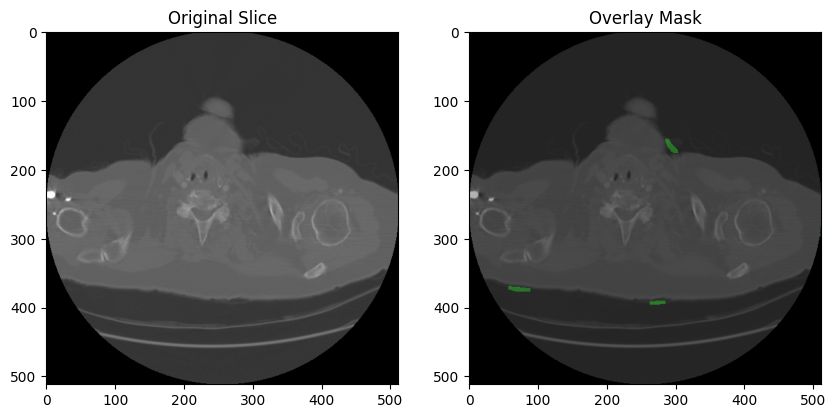

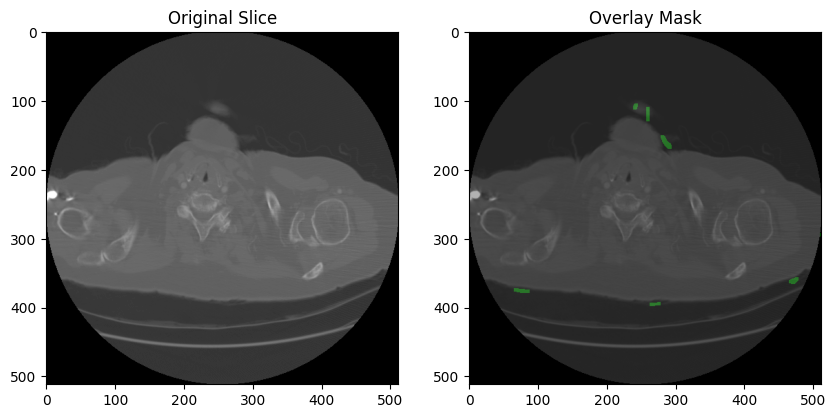

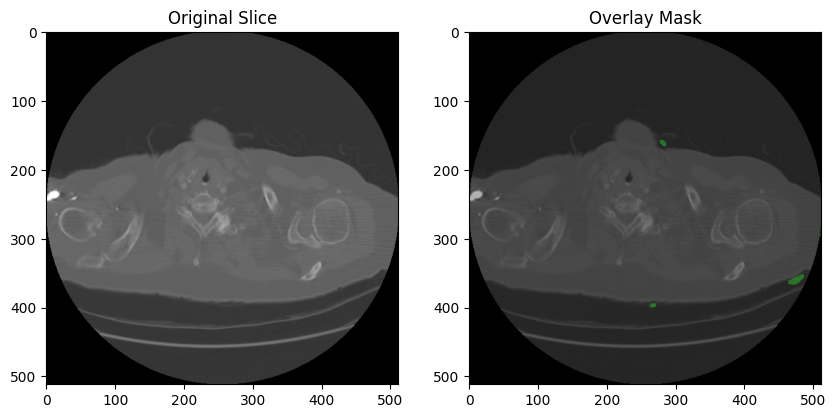

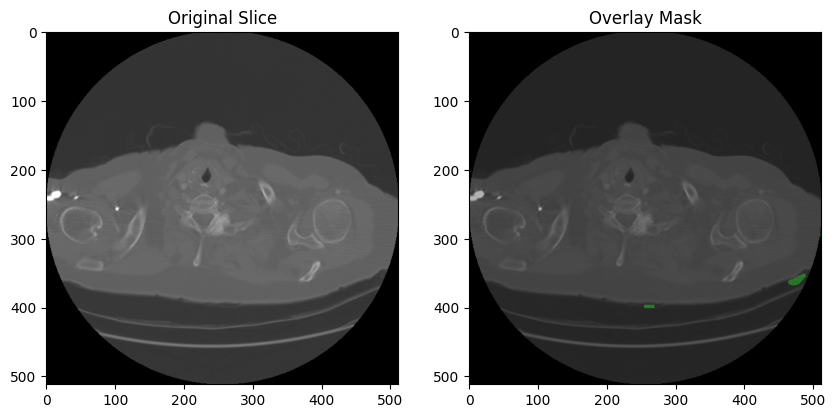

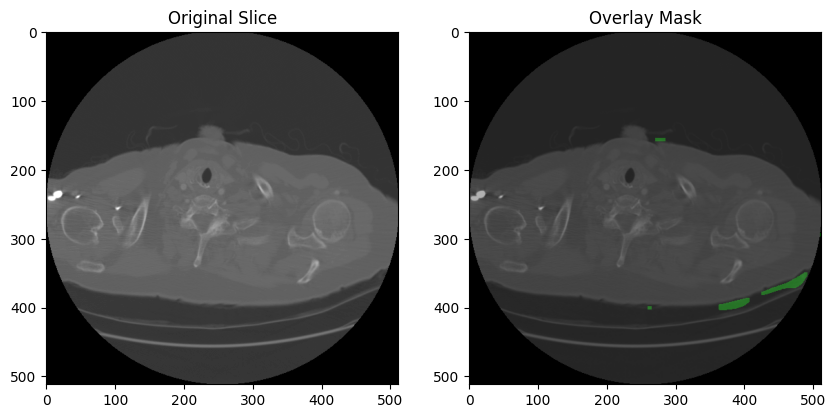

...

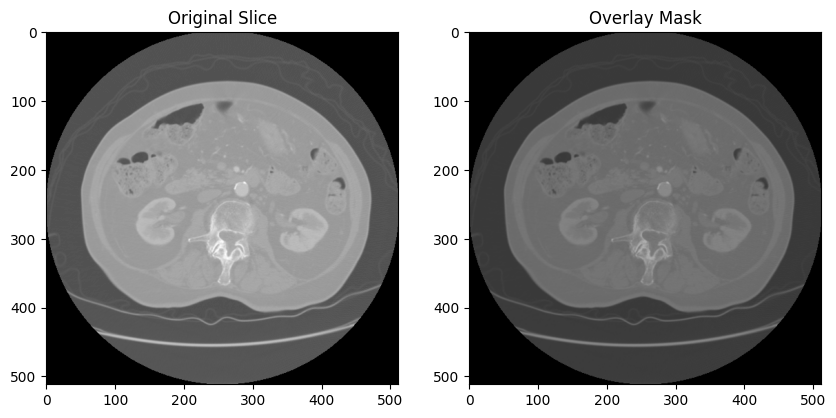

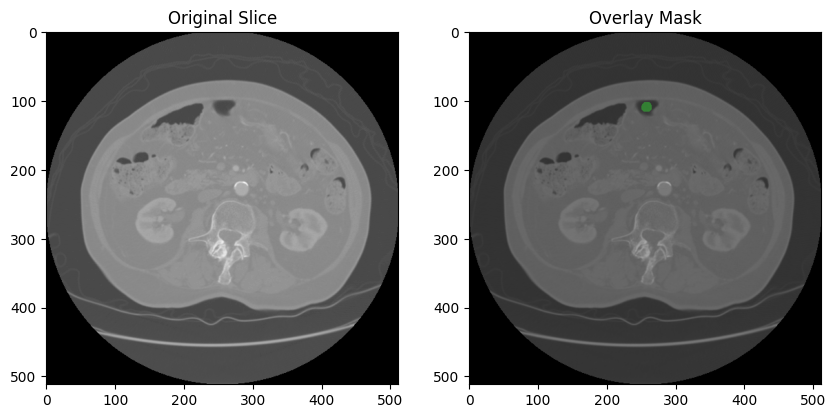

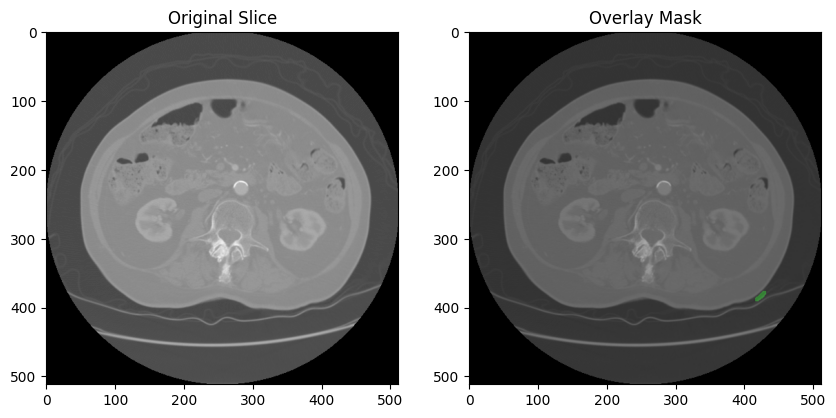

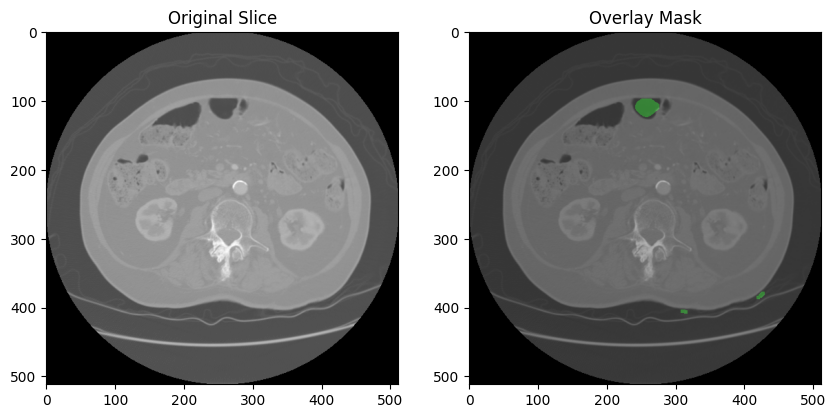

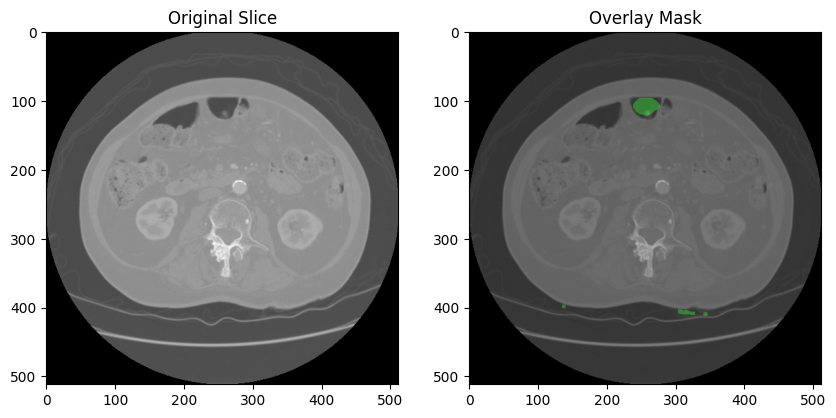

In [375]:
import pydicom
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def load_dicom_series(directory):
    slices = []
    for filename in sorted(os.listdir(directory)):
        if filename.endswith('.dcm'):
            filepath = os.path.join(directory, filename)
            ds = pydicom.dcmread(filepath)
            slices.append(ds)
    slices.sort(key=lambda x: int(x.InstanceNumber))
    return slices

def preprocess_slice(slice, hu_min=-1000, hu_max=400):
    image = slice.pixel_array.astype(np.float32)

    intercept = slice.RescaleIntercept if 'RescaleIntercept' in slice else 0
    slope = slice.RescaleSlope if 'RescaleSlope' in slice else 1
    image = image * slope + intercept

    image = np.clip(image, hu_min, hu_max)
    image = (image - hu_min) / (hu_max - hu_min) * 255

    image = cv2.medianBlur(image.astype(np.uint8), 25)

    image = cv2.GaussianBlur(image, (5, 5), 1)

    # Aplicar equalização de histograma (opcional)
    # image = cv2.equalizeHist(image.astype(np.uint8))

    return image

def plot_histogram(image, hu_min=-1000, hu_max=400):
    plt.hist(image.ravel(), bins=256, range=[hu_min, hu_max])
    plt.xlabel('Hounsfield Units (HU)')
    plt.ylabel('Frequency')
    plt.title('Histogram of CT Image Intensities')
    plt.show()

def segment_lung(image, threshold_min=10, threshold_max=70):
    binary_image = cv2.inRange(image, threshold_min, threshold_max)
    binary_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8))

    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for cnt in contours:
        cv2.drawContours(binary_image, [cnt], 0, 255, -1)

    return binary_image

def postprocess_mask(mask):
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8))
    return mask

def segment_nodules(lung_mask, original_image, nodule_threshold_min=-140, nodule_threshold_max=-180):
    nodule_mask = cv2.inRange(original_image, nodule_threshold_min, nodule_threshold_max)

    nodule_mask = cv2.bitwise_and(nodule_mask, lung_mask)

    nodule_mask = cv2.morphologyEx(nodule_mask, cv2.MORPH_OPEN, np.ones((3, 3), np.uint8))
    nodule_mask = cv2.morphologyEx(nodule_mask, cv2.MORPH_CLOSE, np.ones((3, 3), np.uint8))

    return nodule_mask

def visualize_segmentation(original, lung_mask, nodule_mask):
    if original.dtype != np.uint8:
        original = cv2.normalize(original, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    overlay = np.zeros((original.shape[0], original.shape[1], 3), dtype=np.uint8)
    overlay[lung_mask == 255] = [0, 255, 0]  # verde pulmões
    overlay[nodule_mask == 255] = [255, 0, 0]  # vermelho nódulos

    combined = cv2.addWeighted(cv2.cvtColor(original, cv2.COLOR_GRAY2BGR), 0.7, overlay, 0.3, 0)

    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.title('Original Slice')
    plt.imshow(original, cmap='gray')

    plt.subplot(1, 2, 2)
    plt.title('Overlay Mask')
    plt.imshow(combined)

    plt.show()

directory = '/content/dataset/exam01'
slices = load_dicom_series(directory)

original_slices = [slice.pixel_array for slice in slices]

preprocessed_slices = [preprocess_slice(slice) for slice in slices]

# # Plotar histogramas para cada slice
# for slice in preprocessed_slices:
#     plot_histogram(slice)

threshold_min = 23.4
threshold_max = 50

segmented_slices = [segment_lung(slice, threshold_min, threshold_max) for slice in preprocessed_slices]

postprocessed_masks = [postprocess_mask(mask) for mask in segmented_slices]

nodule_masks = [segment_nodules(lung_mask, original) for lung_mask, original in zip(postprocessed_masks, original_slices)]

for original, lung_mask, nodule_mask in zip(original_slices, postprocessed_masks, nodule_masks):
    visualize_segmentation(original, lung_mask, nodule_mask)
